# Extremely Noisy 4-D STEM Strain Mapping Using Cycle Consistent Spatial Transforming Autoencoders (Simulated 4dstem)

## Package Installation

In [1]:
import sys
!{sys.executable} -m pip install -i https://test.pypi.org/simple/ Auto4DSTEM==0.6.8

Looking in indexes: https://test.pypi.org/simple/


## Package Loading

In [7]:
%load_ext autoreload
%autoreload 2
import os
import torch
import pickle
import warnings
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
from cmcrameri import cm
from auto4dstem.nn.Train_Function import TrainClass
from auto4dstem.Viz.util import download_files_from_txt,download_files_from_txt,mask_class
from auto4dstem.Viz.viz import set_format_Auto4D, visualize_simulate_result, visual_performance_plot,normalized_strain_matrices

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Device Setting

In [8]:
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="1"

if torch.cuda.is_available():
    device = torch.device('cuda')
    print("Using GPU")
else:
    device = torch.device('cpu')
    print("Using CPU")

Using GPU


## Visualization Format 

In [9]:
set_format = set_format_Auto4D()
pylab.rcParams.update(set_format)

In [10]:
warnings.filterwarnings('ignore') 

## Download Data and Pre-Trained Models

In [11]:
folder_name = 'Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated'
file_download =  "simulated_label_weights_affine_para"

In [12]:
# check where are you from the root path
download_files_from_txt(file_download,folder_name)

  1%|█▍                                                                                                  | 1/72 [00:00<00:38,  1.85it/s]

File already exists: 40percent_noisy_simulated_4dstem_pretrained_weights.pkl


  3%|██▊                                                                                                 | 2/72 [00:00<00:34,  2.04it/s]

File already exists: 45percent_noisy_simulated_4dstem_pretrained_weights.pkl


  4%|████▏                                                                                               | 3/72 [00:01<00:32,  2.12it/s]

File already exists: 60Percent_pretrained_rotation.npy


  6%|█████▌                                                                                              | 4/72 [00:01<00:31,  2.14it/s]

File already exists: analysis_bg50per_1e5counts__strain.h5


  7%|██████▉                                                                                             | 5/72 [00:02<00:32,  2.06it/s]

File already exists: 25percent_noisy_simulated_4dstem_pretrained_weights.pkl


  8%|████████▎                                                                                           | 6/72 [00:02<00:31,  2.10it/s]

File already exists: 20Percent_pretrained_rotation.npy


 10%|█████████▋                                                                                          | 7/72 [00:03<00:30,  2.12it/s]

File already exists: Label_shear_xy.npy


 11%|███████████                                                                                         | 8/72 [00:03<00:31,  2.04it/s]

File already exists: Label_strain_yy.npy


 12%|████████████▌                                                                                       | 9/72 [00:04<00:30,  2.09it/s]

File already exists: 25Percent_pretrained_rotation.npy


 14%|█████████████▊                                                                                     | 10/72 [00:04<00:29,  2.11it/s]

File already exists: 10percent_noisy_simulated_4dstem_pretrained_weights.pkl


 15%|███████████████▏                                                                                   | 11/72 [00:05<00:29,  2.09it/s]

File already exists: 30percent_noisy_simulated_4dstem_pretrained_weights.pkl


 17%|████████████████▌                                                                                  | 12/72 [00:05<00:28,  2.13it/s]

File already exists: analysis_bg40per_1e5counts__strain.h5


 18%|█████████████████▉                                                                                 | 13/72 [00:06<00:28,  2.10it/s]

File already exists: 05percent_noisy_simulated_4dstem_pretrained_weights.pkl


 19%|███████████████████▎                                                                               | 14/72 [00:06<00:27,  2.13it/s]

File already exists: 70percent_noisy_simulated_4dstem_pretrained_weights.pkl


 21%|████████████████████▋                                                                              | 15/72 [00:07<00:26,  2.16it/s]

File already exists: analysis_bg45per_1e5counts__strain.h5


 22%|██████████████████████                                                                             | 16/72 [00:07<00:25,  2.19it/s]

File already exists: 00percent_noisy_simulated_4dstem_pretrained_weights.pkl


 24%|███████████████████████▍                                                                           | 17/72 [00:08<00:24,  2.21it/s]

File already exists: 60percent_noisy_simulated_4dstem_pretrained_weights.pkl


 25%|████████████████████████▊                                                                          | 18/72 [00:08<00:24,  2.19it/s]

File already exists: 35percent_noisy_simulated_4dstem_pretrained_weights.pkl


 26%|██████████████████████████▏                                                                        | 19/72 [00:08<00:24,  2.19it/s]

File already exists: 00Percent_pretrained_rotation.npy


 28%|███████████████████████████▌                                                                       | 20/72 [00:09<00:23,  2.21it/s]

File already exists: analysis_bg20per_1e5counts__strain.h5


 29%|████████████████████████████▉                                                                      | 21/72 [00:09<00:23,  2.21it/s]

File already exists: 20percent_noisy_simulated_4dstem_pretrained_weights.pkl


 31%|██████████████████████████████▎                                                                    | 22/72 [00:10<00:22,  2.21it/s]

File already exists: 50percent_noisy_simulated_4dstem_pretrained_weights.pkl


 32%|███████████████████████████████▌                                                                   | 23/72 [00:10<00:22,  2.20it/s]

File already exists: analysis_bg60per_1e5counts__strain.h5


 33%|█████████████████████████████████                                                                  | 24/72 [00:11<00:21,  2.21it/s]

File already exists: analysis_bg70per_1e5counts__strain.h5


 35%|██████████████████████████████████▍                                                                | 25/72 [00:11<00:21,  2.21it/s]

File already exists: 70Percent_pretrained_rotation.npy


 36%|███████████████████████████████████▊                                                               | 26/72 [00:12<00:20,  2.23it/s]

File already exists: 45Percent_pretrained_rotation.npy


 38%|█████████████████████████████████████▏                                                             | 27/72 [00:12<00:20,  2.21it/s]

File already exists: analysis_bg05per_1e5counts__strain.h5


 39%|██████████████████████████████████████▌                                                            | 28/72 [00:12<00:19,  2.22it/s]

File already exists: analysis_bg15per_1e5counts__strain.h5


 40%|███████████████████████████████████████▉                                                           | 29/72 [00:13<00:19,  2.21it/s]

File already exists: 15Percent_pretrained_rotation.npy


 42%|█████████████████████████████████████████▎                                                         | 30/72 [00:13<00:19,  2.10it/s]

File already exists: analysis_bg00per_1e5counts__strain.h5


 43%|██████████████████████████████████████████▋                                                        | 31/72 [00:14<00:19,  2.13it/s]

File already exists: analysis_bg30per_1e5counts__strain.h5


 44%|████████████████████████████████████████████                                                       | 32/72 [00:14<00:18,  2.17it/s]

File already exists: analysis_bg25per_1e5counts__strain.h5


 46%|█████████████████████████████████████████████▍                                                     | 33/72 [00:15<00:17,  2.18it/s]

File already exists: Label_rotation.npy


 47%|██████████████████████████████████████████████▊                                                    | 34/72 [00:15<00:17,  2.16it/s]

File already exists: 15percent_noisy_simulated_4dstem_pretrained_weights.pkl


 49%|████████████████████████████████████████████████▏                                                  | 35/72 [00:16<00:17,  2.16it/s]

File already exists: 10Percent_pretrained_rotation.npy


 50%|█████████████████████████████████████████████████▌                                                 | 36/72 [00:16<00:17,  2.10it/s]

File already exists: 40Percent_pretrained_rotation.npy


 51%|██████████████████████████████████████████████████▊                                                | 37/72 [00:17<00:16,  2.13it/s]

File already exists: 30Percent_pretrained_rotation.npy


 53%|████████████████████████████████████████████████████▎                                              | 38/72 [00:17<00:15,  2.16it/s]

File already exists: 05Percent_pretrained_rotation.npy


 54%|█████████████████████████████████████████████████████▌                                             | 39/72 [00:18<00:15,  2.16it/s]

File already exists: 35Percent_pretrained_rotation.npy


 56%|███████████████████████████████████████████████████████                                            | 40/72 [00:18<00:14,  2.14it/s]

File already exists: analysis_bg10per_1e5counts__strain.h5


 57%|████████████████████████████████████████████████████████▍                                          | 41/72 [00:19<00:14,  2.17it/s]

File already exists: 50Percent_pretrained_rotation.npy


 58%|█████████████████████████████████████████████████████████▊                                         | 42/72 [00:19<00:13,  2.18it/s]

File already exists: analysis_bg35per_1e5counts__strain.h5


 60%|███████████████████████████████████████████████████████████▏                                       | 43/72 [00:19<00:13,  2.21it/s]

File already exists: Label_strain_xx.npy


 61%|████████████████████████████████████████████████████████████▌                                      | 44/72 [00:20<00:12,  2.21it/s]

File already exists: 45Per_2_train_process_scale_shear.npy


 62%|█████████████████████████████████████████████████████████████▉                                     | 45/72 [00:20<00:11,  2.26it/s]

File already exists: 60Per_2_train_process_scale_shear.npy


 64%|███████████████████████████████████████████████████████████████▏                                   | 46/72 [00:21<00:11,  2.22it/s]

File already exists: 30Per_2_train_process_scale_shear.npy


 65%|████████████████████████████████████████████████████████████████▋                                  | 47/72 [00:21<00:11,  2.22it/s]

File already exists: 40Per_2_train_process_rotation.npy


 67%|██████████████████████████████████████████████████████████████████                                 | 48/72 [00:22<00:10,  2.23it/s]

File already exists: 10Per_2_train_process_scale_shear.npy


 68%|███████████████████████████████████████████████████████████████████▍                               | 49/72 [00:22<00:10,  2.13it/s]

File already exists: 20Per_2_train_process_scale_shear.npy


 69%|████████████████████████████████████████████████████████████████████▊                              | 50/72 [00:23<00:10,  2.16it/s]

File already exists: 30Per_2_train_process_rotation.npy


 71%|██████████████████████████████████████████████████████████████████████▏                            | 51/72 [00:23<00:09,  2.15it/s]

File already exists: 05Per_2_train_process_scale_shear.npy


 72%|███████████████████████████████████████████████████████████████████████▌                           | 52/72 [00:24<00:09,  2.17it/s]

File already exists: 05Per_2_train_process_rotation.npy


 74%|████████████████████████████████████████████████████████████████████████▉                          | 53/72 [00:24<00:08,  2.18it/s]

File already exists: 25Per_2_train_process_rotation.npy


 75%|██████████████████████████████████████████████████████████████████████████▎                        | 54/72 [00:25<00:08,  2.09it/s]

File already exists: 45Per_2_train_process_rotation.npy


 76%|███████████████████████████████████████████████████████████████████████████▋                       | 55/72 [00:25<00:08,  2.12it/s]

File already exists: 35Per_2_train_process_scale_shear.npy


 78%|█████████████████████████████████████████████████████████████████████████████                      | 56/72 [00:25<00:07,  2.15it/s]

File already exists: 50Per_2_train_process_scale_shear.npy


 79%|██████████████████████████████████████████████████████████████████████████████▍                    | 57/72 [00:26<00:06,  2.17it/s]

File already exists: 70Per_2_train_process_scale_shear.npy


 81%|███████████████████████████████████████████████████████████████████████████████▊                   | 58/72 [00:26<00:06,  2.19it/s]

File already exists: 00Per_2_train_process_rotation.npy


 82%|█████████████████████████████████████████████████████████████████████████████████▏                 | 59/72 [00:27<00:06,  2.15it/s]

File already exists: 10Per_2_train_process_rotation.npy


 83%|██████████████████████████████████████████████████████████████████████████████████▌                | 60/72 [00:27<00:05,  2.18it/s]

File already exists: 00Per_2_train_process_scale_shear.npy


 85%|███████████████████████████████████████████████████████████████████████████████████▉               | 61/72 [00:28<00:05,  2.17it/s]

File already exists: 20Per_2_train_process_rotation.npy


 86%|█████████████████████████████████████████████████████████████████████████████████████▎             | 62/72 [00:28<00:04,  2.15it/s]

File already exists: 15Per_2_train_process_rotation.npy


 88%|██████████████████████████████████████████████████████████████████████████████████████▋            | 63/72 [00:29<00:04,  2.17it/s]

File already exists: 35Per_2_train_process_rotation.npy


 89%|████████████████████████████████████████████████████████████████████████████████████████           | 64/72 [00:29<00:03,  2.19it/s]

File already exists: 15Per_2_train_process_scale_shear.npy


 90%|█████████████████████████████████████████████████████████████████████████████████████████▍         | 65/72 [00:30<00:03,  2.20it/s]

File already exists: 25Per_2_train_process_scale_shear.npy


 92%|██████████████████████████████████████████████████████████████████████████████████████████▊        | 66/72 [00:30<00:02,  2.20it/s]

File already exists: 40Per_2_train_process_scale_shear.npy
Rate limit reached, waiting to retry...
Rate limit reached, waiting to retry...
Rate limit reached, waiting to retry...
Rate limit reached, waiting to retry...
Rate limit reached, waiting to retry...


 93%|████████████████████████████████████████████████████████████████████████████████████████████▏      | 67/72 [01:03<00:51, 10.26s/it]

File already exists: 50Per_2_train_process_rotation.npy


 94%|█████████████████████████████████████████████████████████████████████████████████████████████▌     | 68/72 [01:04<00:29,  7.31s/it]

File already exists: 60Per_2_train_process_rotation.npy


 96%|██████████████████████████████████████████████████████████████████████████████████████████████▉    | 69/72 [01:04<00:15,  5.25s/it]

File already exists: 70Per_2_train_process_rotation.npy


 97%|████████████████████████████████████████████████████████████████████████████████████████████████▎  | 70/72 [01:04<00:07,  3.81s/it]

File already exists: simulated_4dstem_grain_index.npy


 99%|█████████████████████████████████████████████████████████████████████████████████████████████████▋ | 71/72 [01:05<00:02,  2.80s/it]

File already exists: MAE_list_simulated_4dstem.pickle


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 72/72 [01:05<00:00,  1.09it/s]

File already exists: polycrystal_output4D.mat


## Build mask for training and generating results

### Build Mask

In [41]:
# set mask class
set_mask = mask_class()
# generate mask 
mask_tensor, mask_list = set_mask.mask_ring(radius_1=50, radius_2 = 85)

## Benchmark Simulated 4DSTEM Dataset

### Set BKG level, Load Data and Pre-Trained Weights

In [42]:
bkg_intensity = 0
bkg_str = format(int(bkg_intensity*100),'02d')
data_path = os.path.abspath(f'{folder_name}/polycrystal_output4D.mat')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

## Initialize the training class from noise-free simulated dataset

In [43]:
tc = TrainClass(data_path,
                device = device, 
                transpose = (1,0,3,2),
                background_weight=bkg_intensity,
                learned_rotation=rotation_path,
                adjust_learned_rotation = 0,
                num_base=1,
                up_size=800,
                scale_limit=0.05,
                shear_limit=0.1,
                rotation_limit=0.1,
                trans_limit = 0.15,
                adj_mask_para=0,
                num_mask = 1,
                fixed_mask = mask_list,
                check_mask = None,
                interpolate = True,
                revise_affine = False,
                folder_path = folder_name
                )

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add image-rotation pair to whole dataset


100%|██████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 34073.96it/s]


/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat


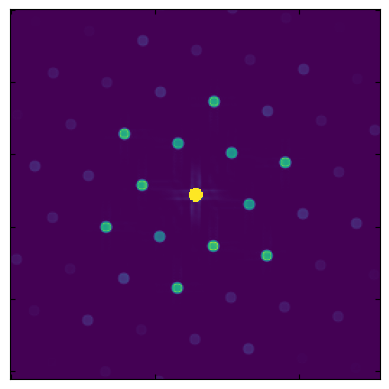

In [44]:
tc.crop_one_image(clim=[0,4e-5])

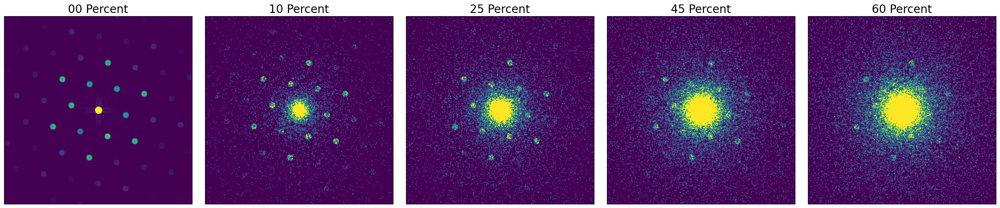

In [45]:
tc.visual_noise(noise_level = [0,0.1,0.25,0.45,0.60],file_name='simulated')

## Load pretrained weight to neural network

In [46]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

## Generate and save results

In [47]:
# # set batch size and load dataset into DataLoader
tc.batch_size = 256
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [26:24<00:00,  6.19s/it]


## Initialize visual result class 

### Set hyper parameters of the class

In [68]:
bkg_intensity = 0
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
rotation_clean = np.load(rotation_path)
scale_shear_clean = np.load(strain_path)

### Visualize results in notebook

In [69]:
img_show = True
if img_show:
    %matplotlib inline
else:
    plt.ioff()

### Create class and visualize rotation result

100%|██████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 51520.45it/s]


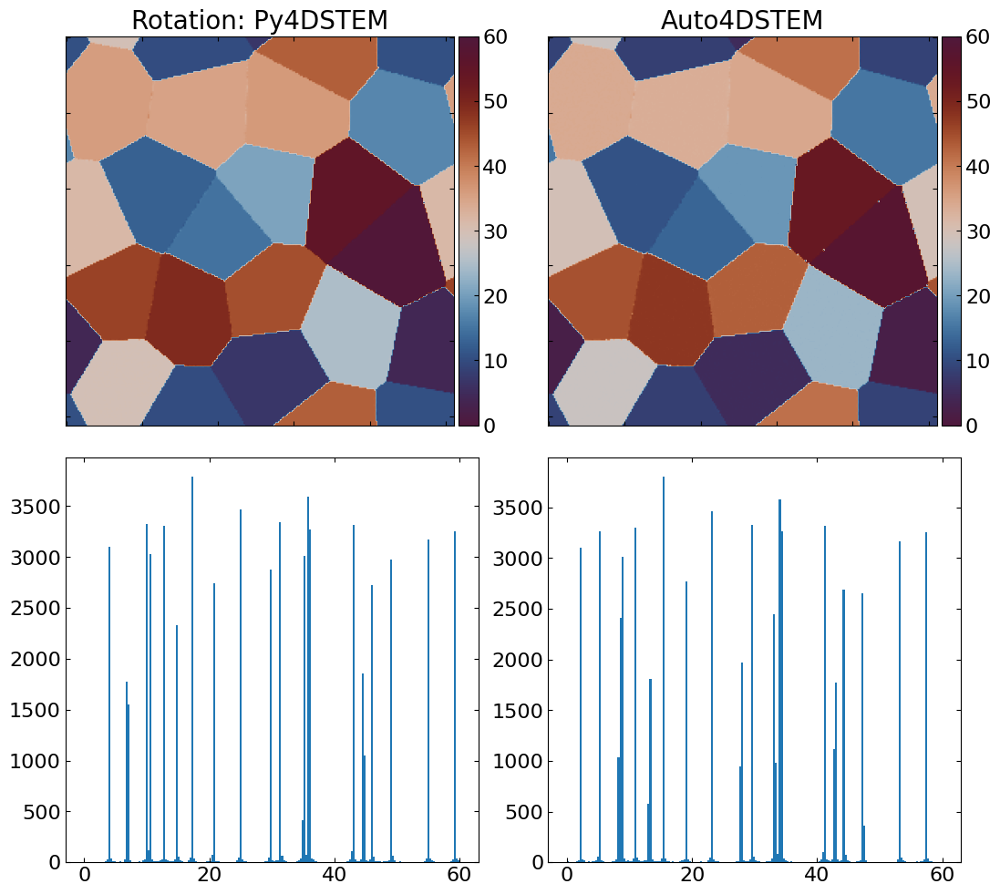

In [70]:
visual = visualize_simulate_result(rotation =  rotation_clean,
                                scale_shear = scale_shear_clean,
                                file_py4DSTEM = file_py4DSTEM,
                                label_rotation_path = folder_name +'/Label_rotation.npy',
                                label_xx_path = folder_name +'/Label_strain_xx.npy',
                                label_yy_path = folder_name +'/Label_strain_yy.npy',
                                label_xy_path = folder_name +'/Label_shear_xy.npy',
                                cmap_rotation = cm.vikO,
                                cmap_strain= cm.vik,
                                cmap_mae=cm.vik,
                                noise_intensity = 0,
                                angle_shift = 25,
                                strain_diff_range = [-0.03,0.03],
                                strain_rotation_range = [-40,30],
                                mae_diff_range = [-0.006,0.006],
                                mae_rotation_range = [-0.5,0.5],
                               )

### Visualize label map

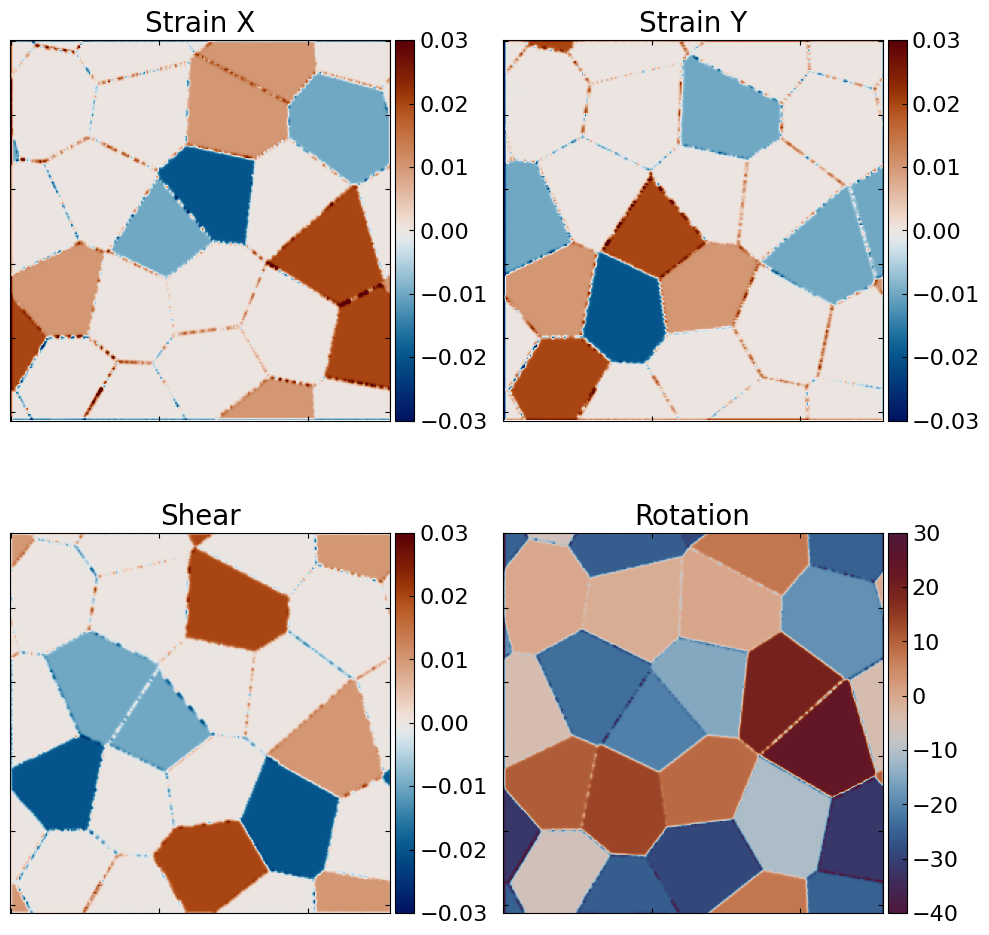

In [71]:
visual.visual_label_map(cmap_strain = cm.vik,
                        cmap_rotation = cm.vikO)

### Visualize strain map result

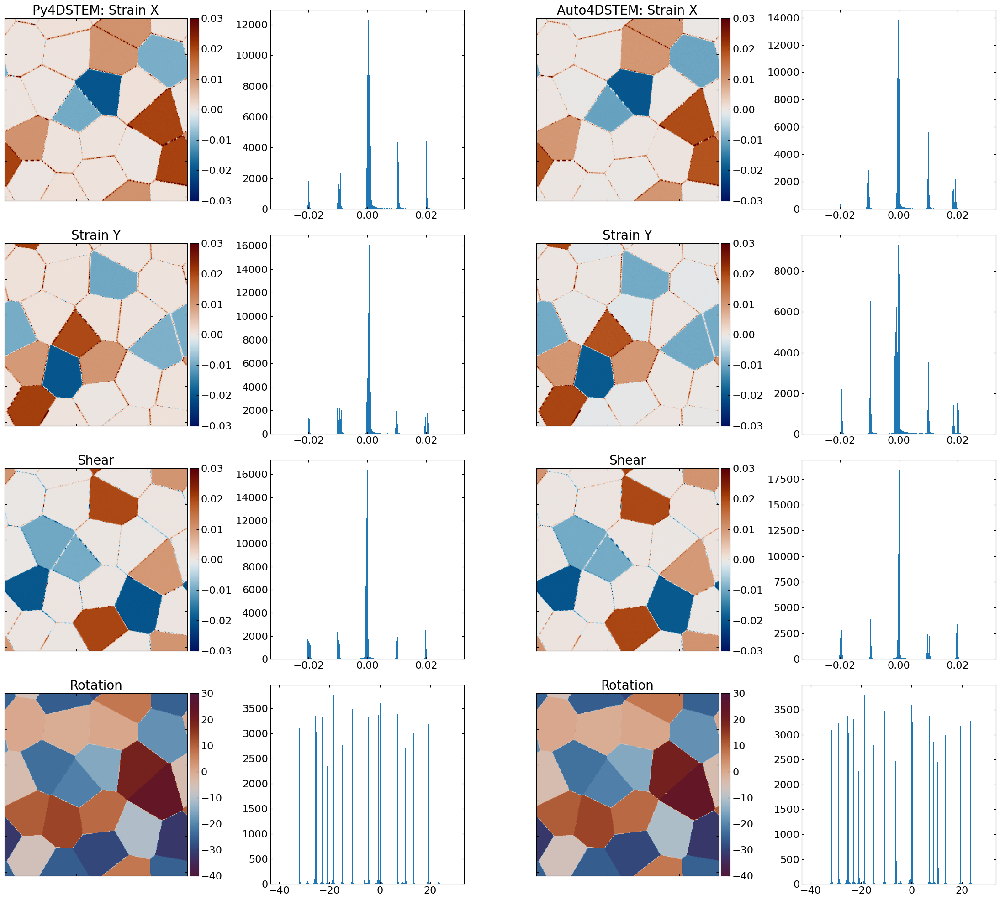

In [72]:
visual.visual_strain()

### Visualize MAE comparison 

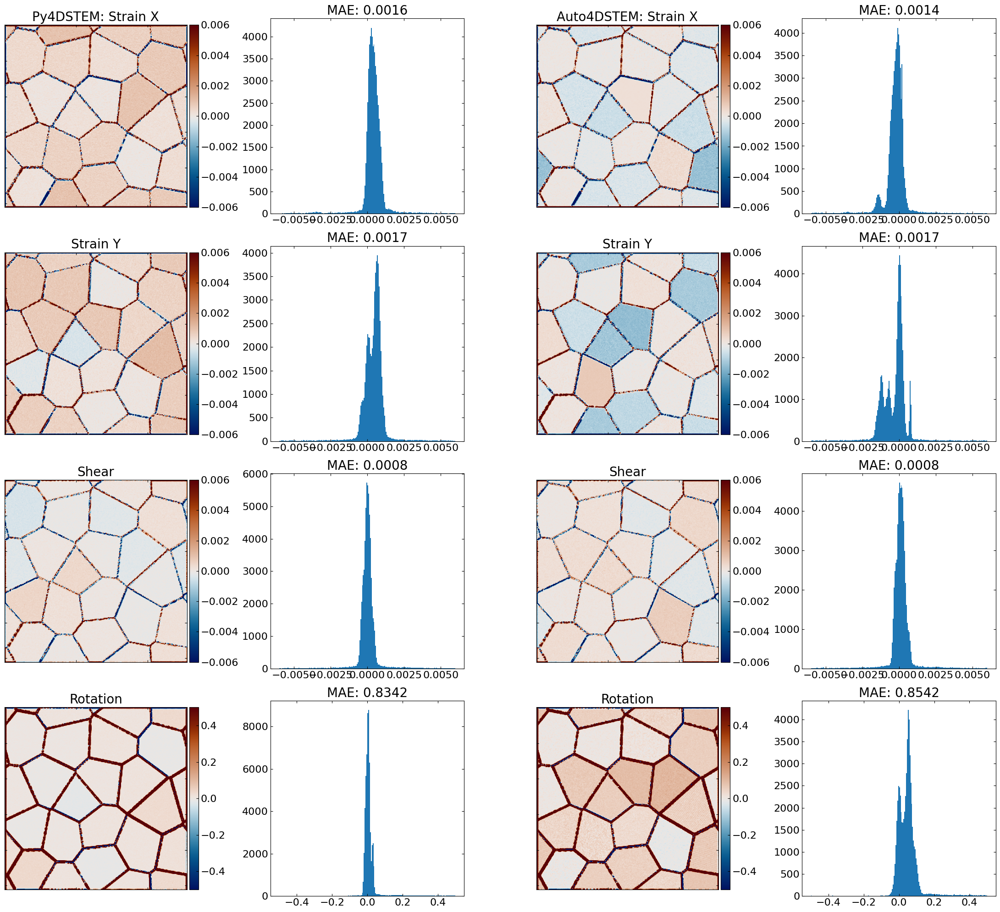

In [73]:
visual.visual_diff()

In [74]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [75]:
visual.add_data_2_plot()

# 05% Noisy 4D STEM

## Load pretraiend weight and rotation path

In [56]:
bkg_intensity = 0.05
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

## Update train class parameter for data generating 

In [57]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = 0

## Generate dataset

In [51]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:18<00:00, 832.54it/s]


add image-rotation pair to whole dataset


100%|████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 228250.07it/s]


## Load pretrained weight to neural network

In [52]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [53]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [17:38<00:00,  4.13s/it]


## Update visual result class
### Set hyper parameters of the class

In [58]:
bkg_intensity = 0.05
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_5per = np.load(rotation_path)
scale_shear_5per = np.load(strain_path)

### Load variable into visualization class

In [59]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_5per
visual.scale_shear = scale_shear_5per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [60]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [61]:
visual.reset_angle(angle_shift=-7)

### Update polar decomposition based on new affine matrix

In [62]:
visual.reset_polar_matrix()

100%|██████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 45075.21it/s]


### Visualize strain map result

In [63]:
visual.visual_strain()

### Visualize MAE comparison

In [64]:
visual.visual_diff()

In [65]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [66]:
visual.add_data_2_plot()

# 10% Noisy 4D STEM

## Load pretraiend weight and rotation path

In [67]:
bkg_intensity = 0.10
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [68]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = -25

## Generate dataset

In [69]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:22<00:00, 798.33it/s]


add image-rotation pair to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 1539475.15it/s]


## Load pretrained weight to neural network

In [70]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [71]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [17:59<00:00,  4.22s/it]


## Update visual result class
### Set hyper parameters of the class

In [63]:
bkg_intensity = 0.10
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_10per = np.load(rotation_path)
scale_shear_10per = np.load(strain_path)

### Load variable into visualization class

In [64]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_10per
visual.scale_shear = scale_shear_10per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [65]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [66]:
visual.reset_angle(angle_shift=-5)

### Update polar decomposition based on new affine matrix

In [67]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 58239.68it/s]


### Visualize strain result

In [68]:
visual.visual_strain()

### visualize MAE comparison

In [69]:
visual.visual_diff()

In [70]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [71]:
visual.add_data_2_plot()

# 15% Noisy 4D STEM

## Load pretraiend weight and rotation path

In [93]:
bkg_intensity = 0.15
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [94]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = 0

## Generate dataset

In [96]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:24<00:00, 772.46it/s]


add image-rotation pair to whole dataset


100%|████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 204812.10it/s]


## Load pretrained weight to neural network

In [97]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [98]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [18:01<00:00,  4.22s/it]


## Update visual result class
### Set hyper parameters of the class

In [73]:
bkg_intensity = 0.15
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_15per = np.load(rotation_path)
scale_shear_15per = np.load(strain_path)

### Load variable into visualization class

In [74]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_15per
visual.scale_shear = scale_shear_15per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [75]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [76]:
visual.reset_angle(angle_shift=-8)

### Update polar decomposition based on new affine matrix

In [77]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 57634.38it/s]


### Visualize strain result

In [78]:
visual.visual_strain()

### visualize MAE comparison

In [79]:
visual.visual_diff()

In [80]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [81]:
visual.add_data_2_plot()

#  20% Noisy 4D STEM 

## Load pretraiend weight and rotation path

In [107]:
bkg_intensity = 0.20
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [108]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = -20

## Generate dataset

In [109]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:27<00:00, 745.60it/s]


add image-rotation pair to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 1623614.34it/s]


## Load pretrained weight to neural network

In [110]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [111]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [17:59<00:00,  4.22s/it]


## Update visual result class
### Set hyper parameters of the class

In [83]:
bkg_intensity = 0.20
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_20per = np.load(rotation_path)
scale_shear_20per = np.load(strain_path)

### Load variable into visualization class

In [84]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_20per
visual.scale_shear = scale_shear_20per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [85]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [86]:
visual.reset_angle(angle_shift=-7)

### Update polar decomposition based on new affine matrix

In [87]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 57516.76it/s]


### Visualize strain result

In [88]:
visual.visual_strain()

### Visualize MAE comparison

In [89]:
visual.visual_diff()

In [90]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [91]:
visual.add_data_2_plot()

# 25% Noisy 4D STEM

## Load pretraiend weight and rotation path

In [120]:
bkg_intensity = 0.25
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [121]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = -15

## Generate dataset

In [122]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:30<00:00, 720.84it/s]


add image-rotation pair to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 1442974.09it/s]


## Load pretrained weight to neural network

In [123]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [124]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [17:29<00:00,  4.10s/it]


## Update visual result class
### Set hyper parameters of the class

In [93]:
bkg_intensity = 0.25
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_25per = np.load(rotation_path)
scale_shear_25per = np.load(strain_path)

### Load variable into visualization class

In [94]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_25per
visual.scale_shear = scale_shear_25per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [95]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [96]:
visual.reset_angle(angle_shift=-9)

### Update polar decomposition based on new affine matrix

In [97]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 57284.01it/s]


### Visualize strain result

In [98]:
visual.visual_strain()

### Visualize MAE comparison

In [99]:
visual.visual_diff()

In [100]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [101]:
visual.add_data_2_plot()

# Visualize 30Percent Background

## Load pretraiend weight and rotation path

In [133]:
bkg_intensity = 0.30
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [134]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = -30

## Generate dataset

In [135]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:33<00:00, 703.38it/s]


add image-rotation pair to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 1457372.31it/s]


## Load pretrained weight to neural network

In [136]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [137]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [18:01<00:00,  4.23s/it]


## Update visual result class
### Set hyper parameters of the class

In [103]:
bkg_intensity = 0.30
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_30per = np.load(rotation_path)
scale_shear_30per = np.load(strain_path)

### Load variable into visualization class

In [104]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_30per
visual.scale_shear = scale_shear_30per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [105]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [106]:
visual.reset_angle(angle_shift=-9)

### Update polar decomposition based on new affine matrix

In [107]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 57993.20it/s]


### Visualize strain result

In [108]:
visual.visual_strain()

### Visualize MAE comparison

In [109]:
visual.visual_diff()

In [110]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [111]:
visual.add_data_2_plot()

# Visualize 35Percent Background

## Load pretraiend weight and rotation path

In [146]:
bkg_intensity = 0.35
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [147]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = -5

## Generate dataset

In [148]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:35<00:00, 684.63it/s]


add image-rotation pair to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 1743430.10it/s]


## Load pretrained weight to neural network

In [149]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [150]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [17:55<00:00,  4.20s/it]


## Update visual result class
### Set hyper parameters of the class

In [113]:
bkg_intensity = 0.35
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_35per = np.load(rotation_path)
scale_shear_35per = np.load(strain_path)

### Load variable into visualization class

In [114]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_35per
visual.scale_shear = scale_shear_35per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [115]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [116]:
visual.reset_angle(angle_shift=-6)

### Update polar decomposition based on new affine matrix

In [117]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 58279.53it/s]


### Visualize strain result

In [118]:
visual.visual_strain()

### visualize MAE comparison

In [119]:
visual.visual_diff()

In [120]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [121]:
visual.add_data_2_plot()

# Visualize 40Percent Background

## Load pretraiend weight and rotation path

In [159]:
bkg_intensity = 0.40
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [160]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = -25

## Generate dataset

In [161]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:38<00:00, 667.07it/s]


add image-rotation pair to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 1502007.61it/s]


## Load pretrained weight to neural network

In [162]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [163]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [18:03<00:00,  4.23s/it]


## Update visual result class
### Set hyper parameters of the class

In [123]:
bkg_intensity = 0.40
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_40per = np.load(rotation_path)
scale_shear_40per = np.load(strain_path)

### Load variable into visualization class

In [124]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_40per
visual.scale_shear = scale_shear_40per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [125]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [126]:
visual.reset_angle(angle_shift=-8)

### Update polar decomposition based on new affine matrix

In [127]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 57879.06it/s]


### Visualize strain result

In [128]:
visual.visual_strain()

### visualize MAE comparison

In [129]:
visual.visual_diff()

In [130]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [131]:
visual.add_data_2_plot()

# Visualize 45Percent Background

## Load pretraiend weight and rotation path

In [172]:
bkg_intensity = 0.45
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [173]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = -40

## Generate dataset

In [174]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:39<00:00, 655.80it/s]


add image-rotation pair to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 1779859.28it/s]


## Load pretrained weight to neural network

In [175]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [176]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [18:05<00:00,  4.24s/it]


## Update visual result class
### Set hyper parameters of the class

In [133]:
bkg_intensity = 0.45
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_45per = np.load(rotation_path)
scale_shear_45per = np.load(strain_path)

### Load variable into visualization class

In [134]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_45per
visual.scale_shear = scale_shear_45per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [135]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [136]:
visual.reset_angle(angle_shift=-7)

### Update polar decomposition based on new affine matrix

In [137]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 58099.60it/s]


### Visualize strain result

In [138]:
visual.visual_strain()

### visualize MAE comparison

In [139]:
visual.visual_diff()

In [140]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [141]:
visual.add_data_2_plot()

# Visualize 50Percent Background

## Load pretraiend weight and rotation path

In [185]:
bkg_intensity = 0.50
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [186]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = -20

## Generate dataset

In [187]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:41<00:00, 644.26it/s]


add image-rotation pair to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 1704235.87it/s]


## Load pretrained weight to neural network

In [188]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [189]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [17:58<00:00,  4.21s/it]


## Update visual result class
### Set hyper parameters of the class

In [143]:
bkg_intensity = 0.50
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_50per = np.load(rotation_path)
scale_shear_50per = np.load(strain_path)

### Load variable into visualization class

In [144]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_50per
visual.scale_shear = scale_shear_50per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [145]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [146]:
visual.reset_angle(angle_shift=-6)

### Update polar decomposition based on new affine matrix

In [147]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 58321.47it/s]


### Visualize strain result

In [148]:
visual.visual_strain()

### Visualize MAE comparison

In [149]:
visual.visual_diff()

In [150]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [151]:
visual.add_data_2_plot()

# Visualize 60Percent Background

## Load pretraiend weight and rotation path

In [248]:
bkg_intensity = 0.60
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [199]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = 1

## Generate dataset

In [200]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:45<00:00, 622.98it/s]


add image-rotation pair to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 1714579.19it/s]


## Load pretrained weight to neural network

In [201]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [202]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [18:00<00:00,  4.22s/it]


## Update visual result class
### Set hyper parameters of the class

In [20]:
bkg_intensity = 0.60
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_60per = np.load(rotation_path)
scale_shear_60per = np.load(strain_path)

### Load variable into visualization class

In [21]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_60per
visual.scale_shear = scale_shear_60per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [22]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [23]:
visual.reset_angle(angle_shift=-9)

### Update polar decomposition based on new affine matrix

In [24]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 48621.55it/s]


### Visualize strain result

In [25]:
visual.visual_strain()

### Visualize MAE comparison

In [26]:
visual.mae_diff_range = [-0.01,0.01]
visual.visual_diff()

In [27]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [28]:
visual.add_data_2_plot()

# Visualize 70Percent Background

## Load pretraiend weight and rotation path

In [211]:
bkg_intensity = 0.70
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Percent_pretrained_rotation.npy'

### Add extra rotation accoding to training strategy

In [212]:
tc.background_weight= bkg_intensity
tc.learned_rotation = rotation_path
# add extra rotation accoding to training strategy
tc.adjust_learned_rotation = 20

## Generate dataset

In [213]:
tc.reset_dataset()

/home/jca92/shuyu/Simulate_4d_stem_folder/Extremely_Noisy_4DSTEM_Strain_Mapping_Using_CC_ST_AE_Simulated/polycrystal_output4D.mat
add Poison distributed background noise to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [01:47<00:00, 606.94it/s]


add image-rotation pair to whole dataset


100%|███████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:00<00:00, 1741817.15it/s]


## Load pretrained weight to neural network

In [214]:
weight_path = f"{folder_name}/{bkg_str}percent_noisy_simulated_4dstem_pretrained_weights.pkl"
tc.load_pretrained_weight(weight_path)

In [215]:
tc.predict(train_process='2',
           save_strain = True,
           save_rotation = True,
           file_name=bkg_intensity)

100%|████████████████████████████████████████████████████████████████████████████████████████████| 256/256 [17:59<00:00,  4.22s/it]


## Update visual result class
### Set hyper parameters of the class

In [29]:
bkg_intensity = 0.70
bkg_str = format(int(bkg_intensity*100),'02d')
rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
rotation_70per = np.load(rotation_path)
scale_shear_70per = np.load(strain_path)

### Load variable into visualization class

In [30]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_70per
visual.scale_shear = scale_shear_70per
visual.noise_intensity = bkg_intensity

### Reset baseline of py4DSTEM

In [31]:
visual.reset_baseline()

### Shift angle to compare appropriately

In [32]:
visual.reset_angle(angle_shift=-8)

### Update polar decomposition based on new affine matrix

In [33]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 47703.49it/s]


### Visualize strain result

In [34]:
visual.visual_strain()

### Visualize MAE comparison

In [35]:
visual.mae_diff_range = [-0.015,0.015]
visual.visual_diff()

In [36]:
visual.record_performance(data_index=True,
                          data_index_path=f'{folder_name}/simulated_4dstem_grain_index.npy',
                          show_index_map=False,
                          width=2)

In [37]:
visual.add_data_2_plot()

## Visualize FPGA model performance
### Clean dataset

In [14]:
# create list of tuple of fpga results
fpga = []

In [15]:
bkg_intensity = 0
bkg_str = format(int(bkg_intensity*100),'02d')
# rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
# strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
load_0_fpga = np.load('distilled_0.npy')
rotation_0_fpga, scale_0_fpga = load_0_fpga[:, 0:2], load_0_fpga[:, 2:]

### Load variable into visualization class

In [16]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_0_fpga
visual.scale_shear = scale_0_fpga
visual.noise_intensity = bkg_intensity
visual.folder_name = folder_name

### Reset baseline of py4DSTEM

In [17]:
visual.reset_baseline()

### Shift angle to compare appropriately

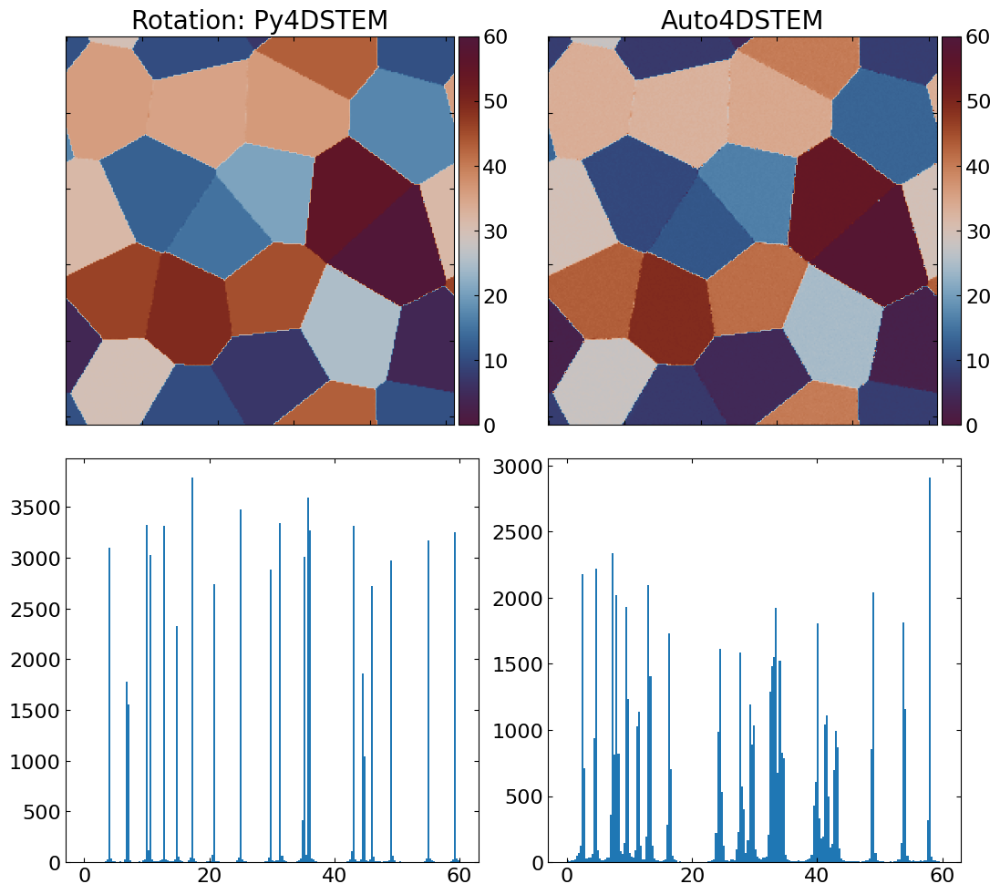

In [18]:
visual.reset_angle(angle_shift=25)

### Update polar decomposition based on new affine matrix

In [19]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 51692.80it/s]


### Visualize strain result

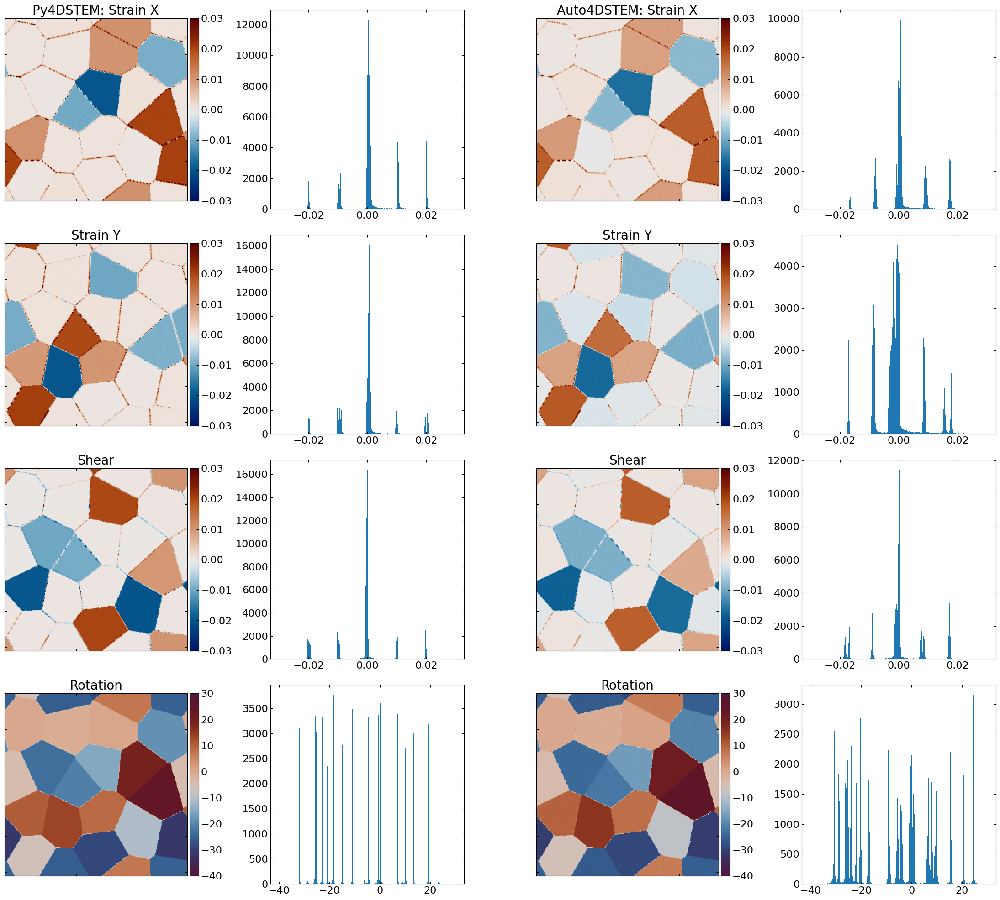

In [20]:
visual.visual_strain()

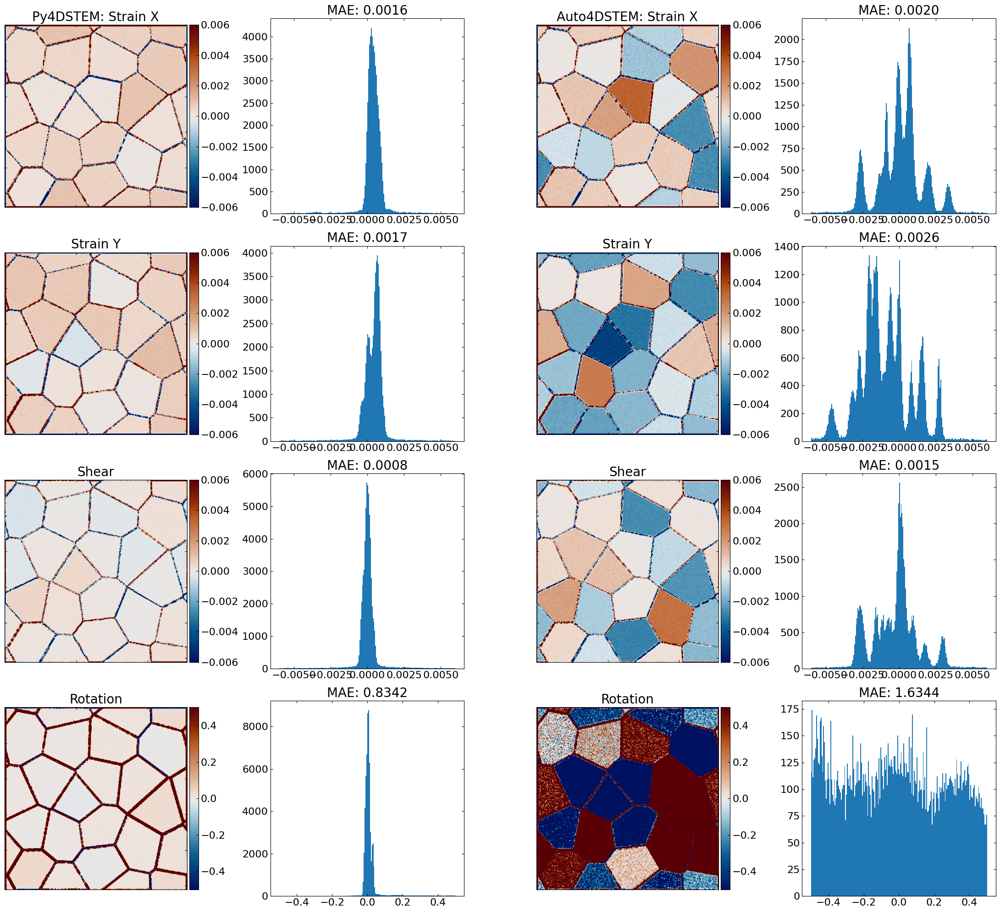

In [21]:
visual.visual_diff()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 51996.95it/s]


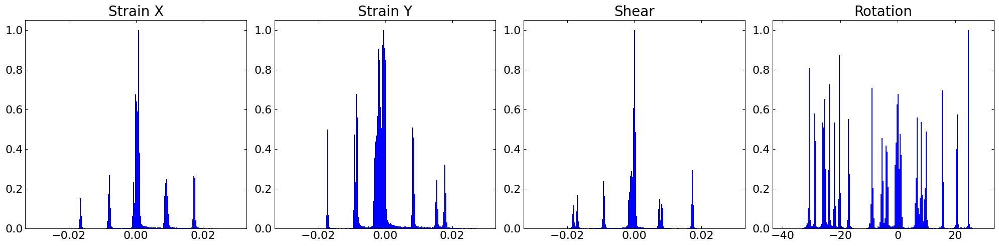

In [22]:
_0 = visual.show_normalized_results(file_name='FPGA_on_0Per_Result',angle_shift=25)

In [23]:
fpga.append(_0)

# 25% BKG on FPGA

In [24]:
bkg_intensity = 0.25
bkg_str = format(int(bkg_intensity*100),'02d')
# rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
# strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
load_25_fpga = np.load('distilled_25.npy')
rotation_25_fpga, scale_25_fpga = load_25_fpga[:, 0:2], load_25_fpga[:, 2:]

### Load variable into visualization class

In [25]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_25_fpga
visual.scale_shear = scale_25_fpga
visual.noise_intensity = bkg_intensity
visual.folder_name = folder_name

### Reset baseline of py4DSTEM

In [26]:
visual.reset_baseline()

### Shift angle to compare appropriately

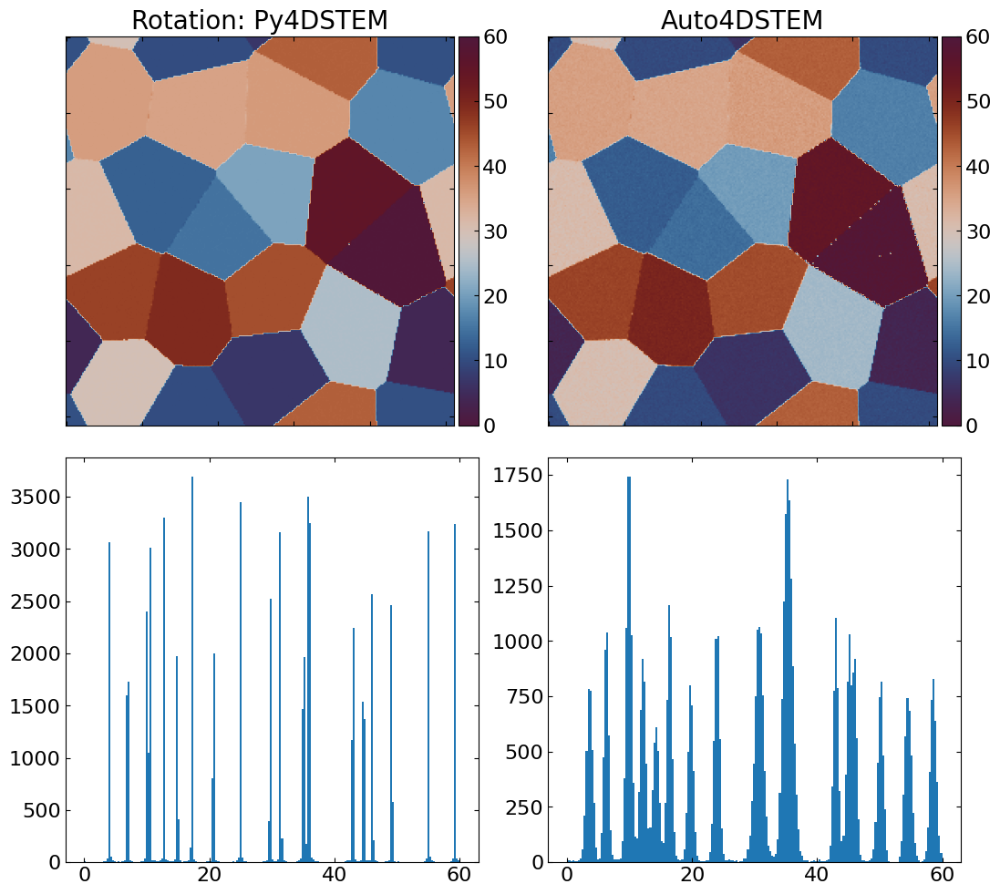

In [27]:
visual.reset_angle(angle_shift=-9)

### Update polar decomposition based on new affine matrix

In [28]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 51590.70it/s]


### Visualize strain result

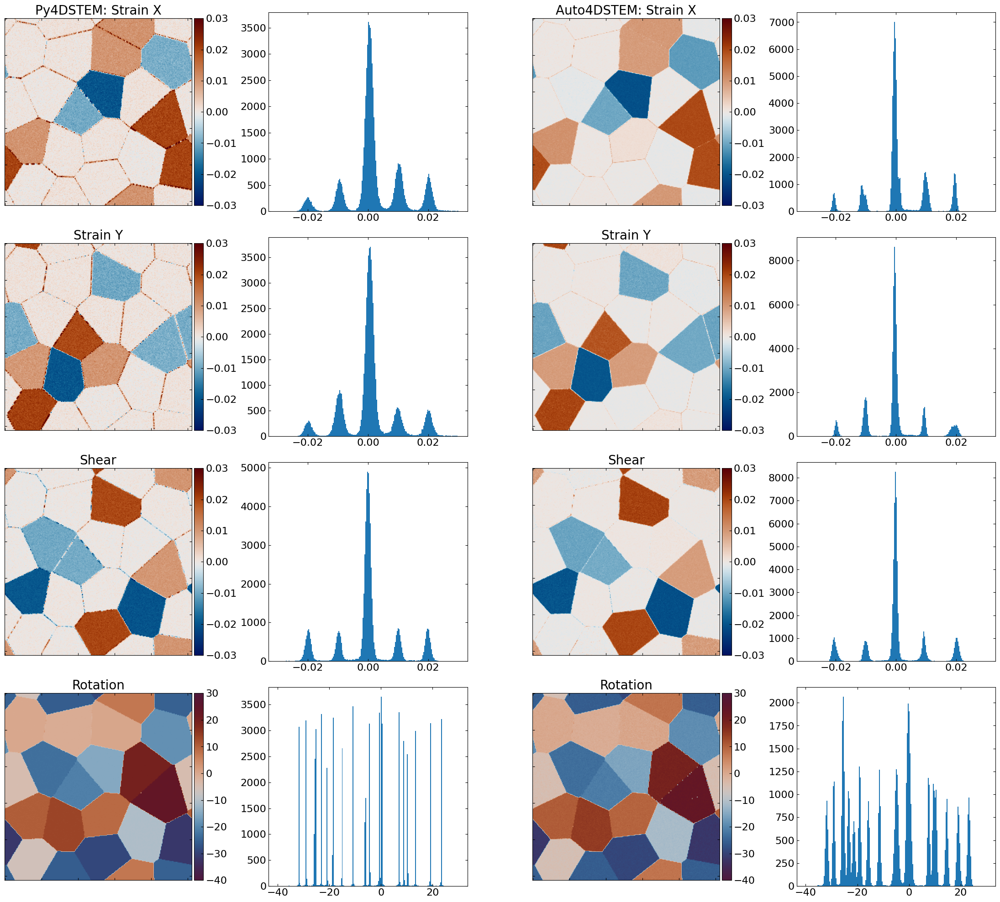

In [29]:
visual.visual_strain()

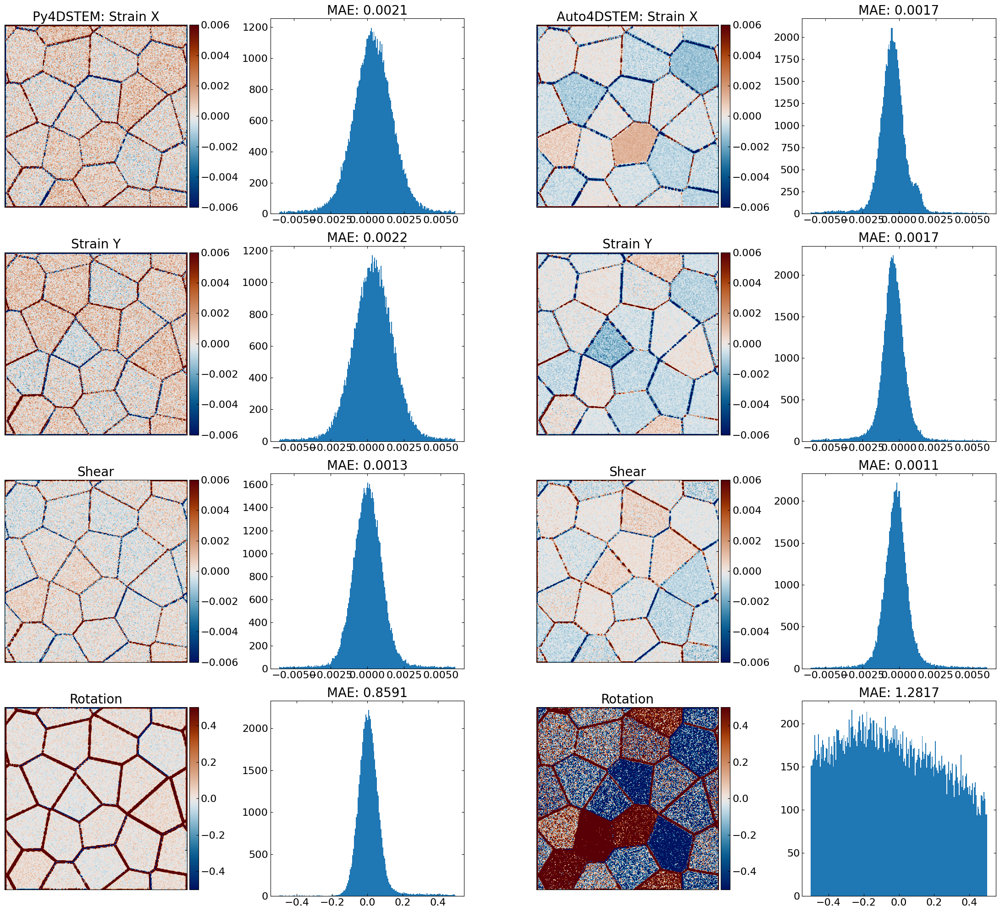

In [30]:
visual.visual_diff()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 52595.06it/s]


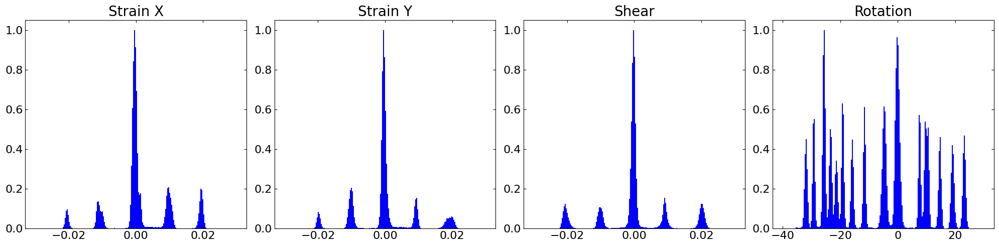

In [31]:
_25 = visual.show_normalized_results(file_name='FPGA_on_25Per_Result',angle_shift=-9)

In [32]:
fpga.append(_25)

## 60% BKG FPGA

In [33]:
bkg_intensity = 0.60
bkg_str = format(int(bkg_intensity*100),'02d')
# rotation_path = f'{folder_name}/{bkg_str}Per_2_train_process_rotation.npy'
# strain_path = f'{folder_name}/{bkg_str}Per_2_train_process_scale_shear.npy'
load_60_fpga = np.load('distilled_60.npy')
rotation_60_fpga, scale_60_fpga = load_60_fpga[:, 0:2], load_60_fpga[:, 2:]

### Load variable into visualization class

In [34]:
visual.file_py4DSTEM = f'{folder_name}/analysis_bg{bkg_str}per_1e5counts__strain.h5'
visual.rotation = rotation_60_fpga
visual.scale_shear = scale_60_fpga
visual.noise_intensity = bkg_intensity
visual.folder_name = folder_name

### Reset baseline of py4DSTEM

In [35]:
visual.reset_baseline()

### Shift angle to compare appropriately

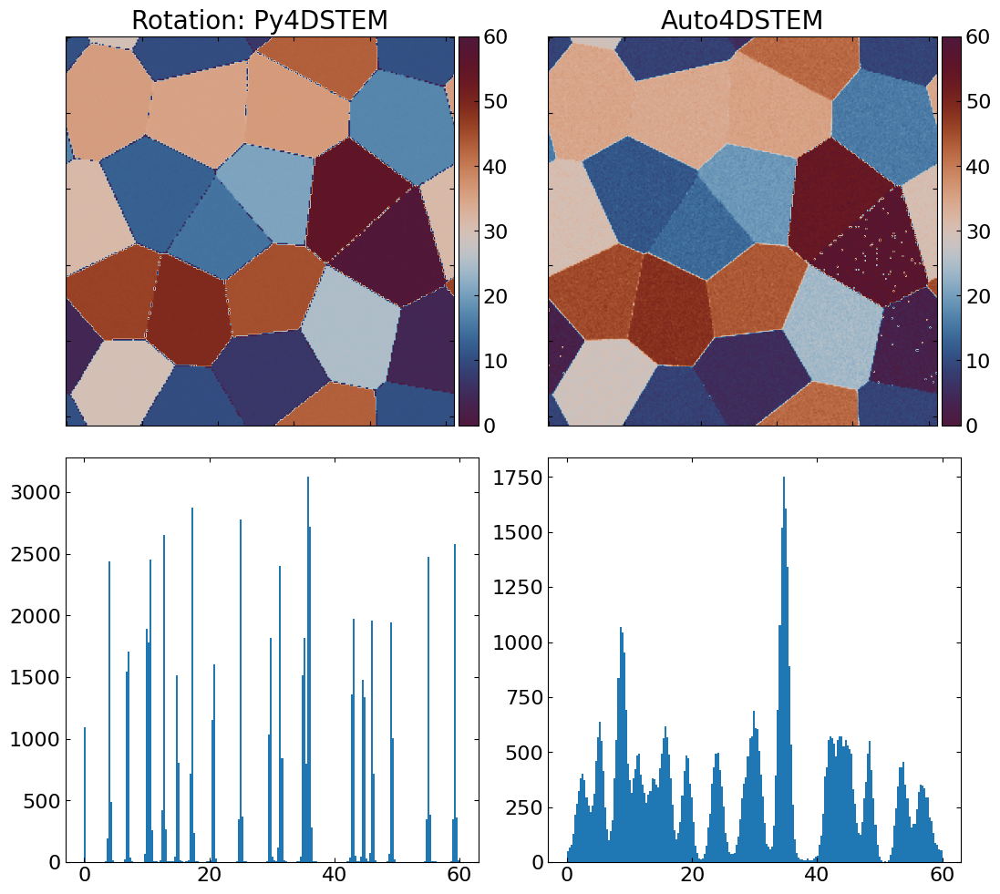

In [36]:
visual.reset_angle(angle_shift=-9)

### Update polar decomposition based on new affine matrix

In [37]:
visual.reset_polar_matrix()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 51947.79it/s]


### Visualize strain result

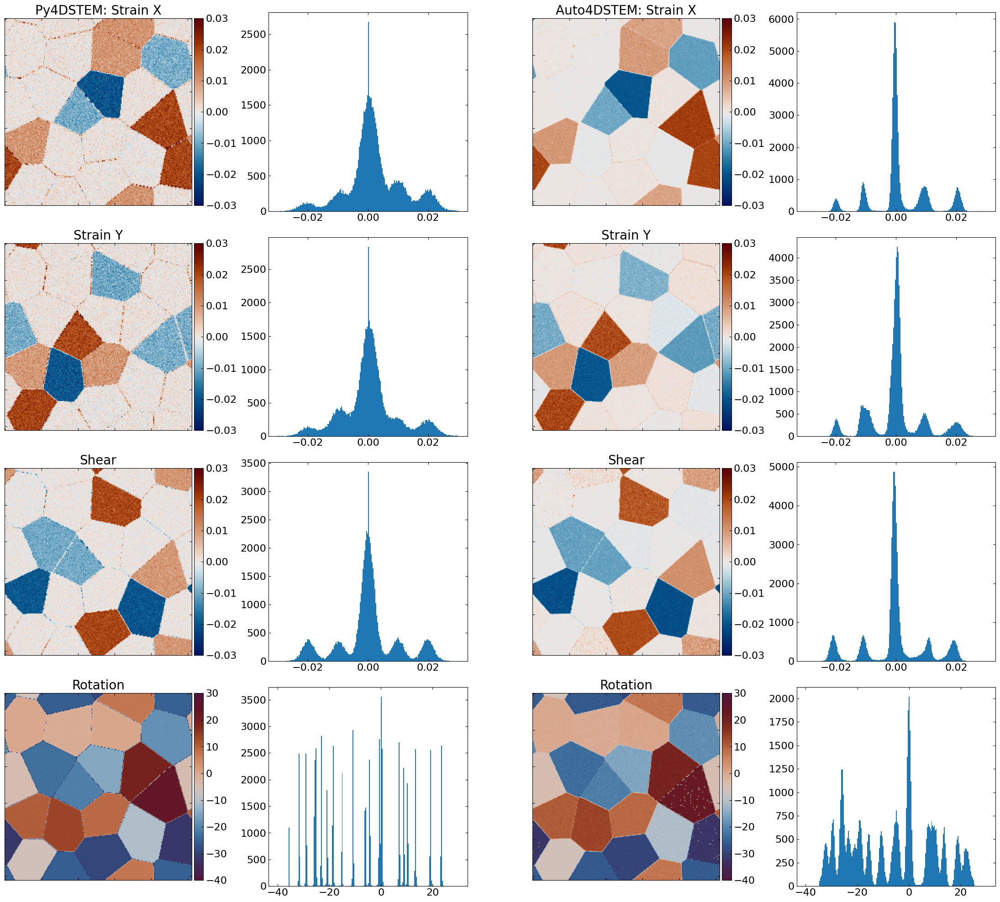

In [38]:
visual.visual_strain()

### Visualize MAE comparison

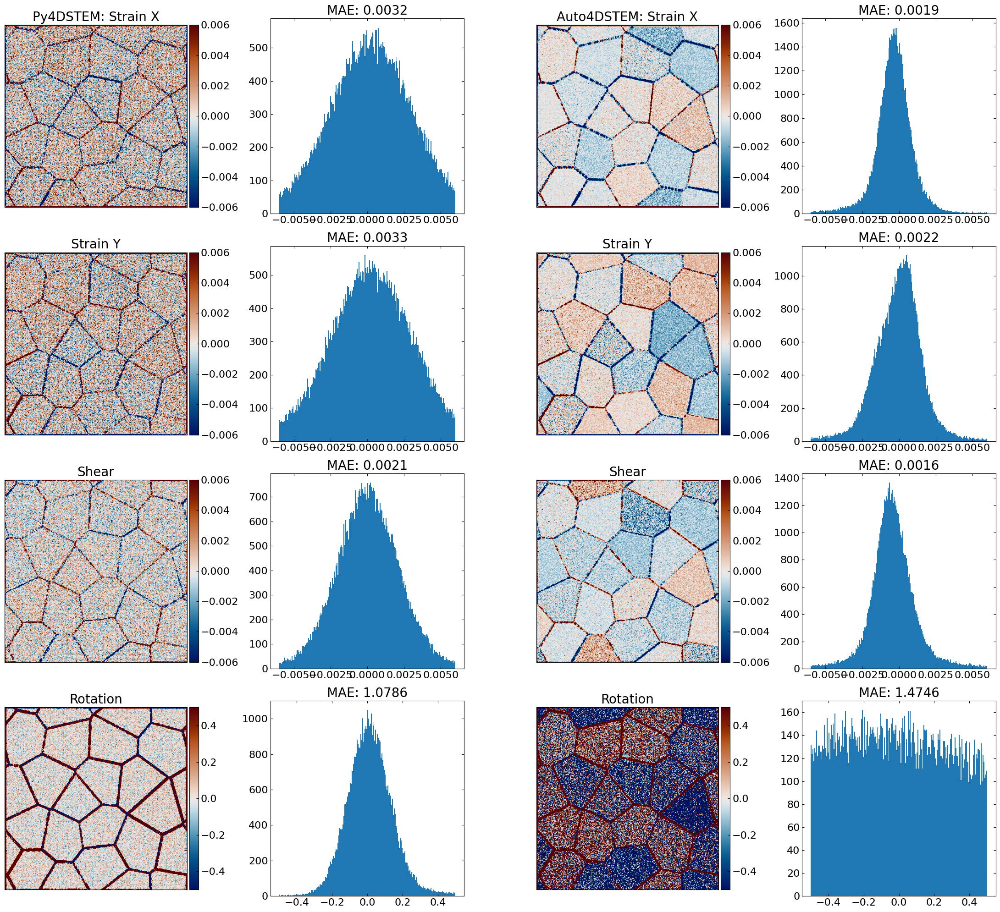

In [39]:
#visual.mae_diff_range = [-0.015,0.015]
visual.visual_diff()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 52179.18it/s]


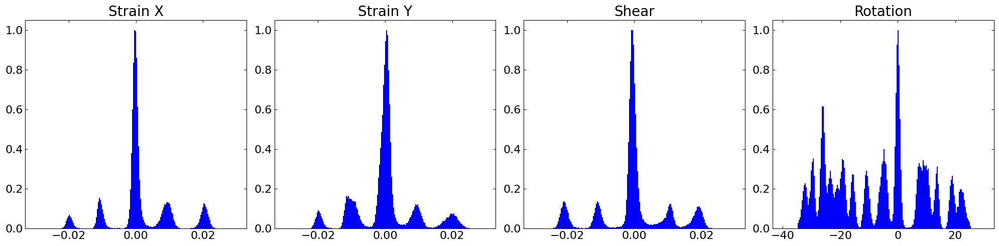

In [40]:
_60 = visual.show_normalized_results(file_name='FPGA_on_60Per_Result',angle_shift=-9)

In [41]:
fpga.append(_60)

## Visualize fpga normalized results

In [46]:
fpga.reverse()

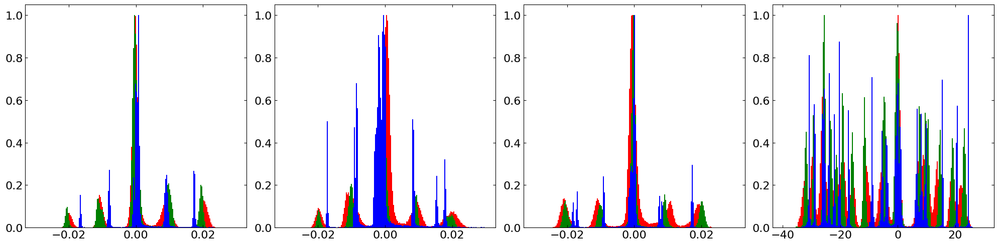

In [47]:
normalized_strain_matrices(fpga,
#                           color_list=['blue','green','red'],
                           file_name='fpga')

## Visualize performance of both methods

In [48]:
img_show = True
if img_show:
    %matplotlib inline
else:
    plt.ioff()

In [49]:
direct_load = True
if direct_load:
    with open(f'{folder_name}/MAE_list_simulated_4dstem.pickle', 'rb') as pickle_file:
        visual.list_of_dic = pickle.load(pickle_file)

### Generate various noise level plots of both methods
### Generate Strain XX results

In [66]:
# maually_record_fpga_results

x_add = [0,0.25,0.6]
fpga_xx = [0.002,0.0017,0.0019]
fpga_yy = [0.0026,0.0017,0.0022]
fpga_xy = [0.0015,0.0011,0.0016]
fpga_rot = [1.63,1.28,1.47]

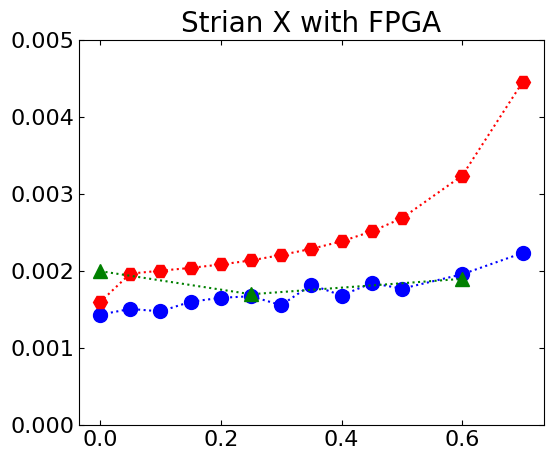

In [76]:
visual_performance_plot(x_list=visual.extract_ele_from_dic(0)[0],
                        auto=visual.extract_ele_from_dic(4)[1],
                        py4d=visual.extract_ele_from_dic(0)[1],
#                         auto_yerr =visual.extract_ele_from_dic(12)[1],
#                         py4d_yerr =visual.extract_ele_from_dic(8)[1],
                        title = 'Strian X with FPGA',
                        xlabel = '',
                        ylabel ='',
                        add_x = x_add,
                        add_y = fpga_xx,
                        marker_list = ['o','H','^'],
                        figsize=(6,5),
                        ylim = [0,0.005],
                        fill_between = False,
                        errorbar= False,
                        folder_path='save_figures/')

### Generate Strain YY results

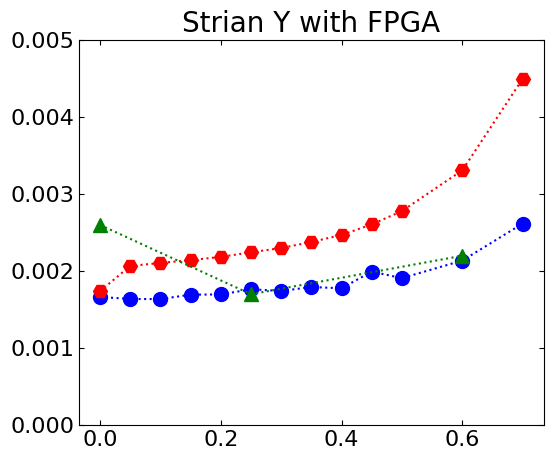

In [77]:
visual_performance_plot(x_list=visual.extract_ele_from_dic(0)[0],
                        auto=visual.extract_ele_from_dic(5)[1],
                        py4d=visual.extract_ele_from_dic(1)[1],
                        auto_yerr =visual.extract_ele_from_dic(13)[1],
                        py4d_yerr =visual.extract_ele_from_dic(9)[1],
                        title = 'Strian Y with FPGA',
                        xlabel = '',
                        ylabel ='',
                        add_x = x_add,
                        add_y = fpga_yy,
                        marker_list = ['o','H','^'],
                        figsize=(6,5),
                        ylim = [0,0.005],
                        fill_between = False,
                        errorbar=False,
                        folder_path='save_figures/')

### Generate Strain XY results

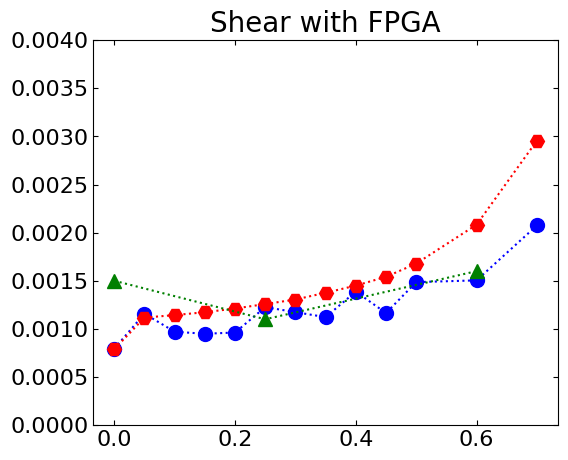

In [78]:
visual_performance_plot(x_list=visual.extract_ele_from_dic(0)[0],
                        auto=visual.extract_ele_from_dic(6)[1],
                        py4d=visual.extract_ele_from_dic(2)[1],
                        auto_yerr =visual.extract_ele_from_dic(14)[1],
                        py4d_yerr =visual.extract_ele_from_dic(10)[1],
                        title = 'Shear with FPGA',
                        xlabel = '',
                        ylabel ='',
                        add_x = x_add,
                        add_y = fpga_xy,
                        marker_list = ['o','H','^'],
                        figsize=(6,5),
                        ylim = [0,0.004],
                        fill_between = False,
                        errorbar=False,
                        folder_path='save_figures/')

### Generate Rotation results

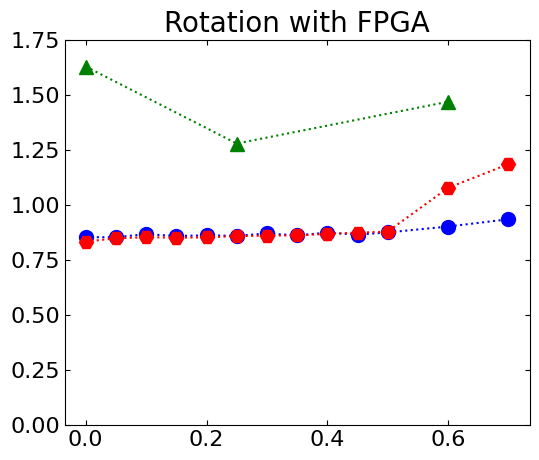

In [79]:
visual_performance_plot(x_list=visual.extract_ele_from_dic(0)[0],
                        auto=visual.extract_ele_from_dic(7)[1],
                        py4d=visual.extract_ele_from_dic(3)[1],
                        auto_yerr =visual.extract_ele_from_dic(15)[1],
                        py4d_yerr =visual.extract_ele_from_dic(11)[1],
                        title = 'Rotation with FPGA',
                        xlabel = '',
                        ylabel ='',
                        add_x = x_add,
                        add_y = fpga_rot,
                        marker_list = ['o','H','^'],
                        figsize=(6,5),
                        ylim = [0,1.75],
                        fill_between = False,
                        errorbar= False,
                        folder_path='save_figures/')

### Generate various noise level histogram of both methods

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 65536/65536 [00:01<00:00, 47807.03it/s]


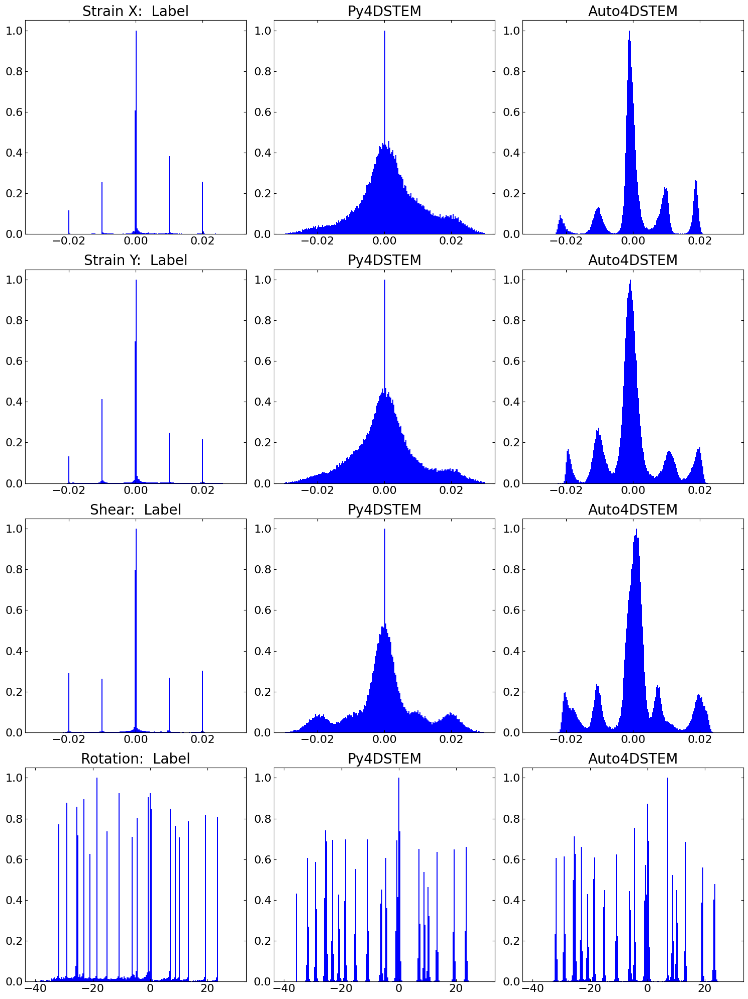

In [53]:
visual.folder_name = folder_name
visual.show_normalized_comparison_results(noise_intensity=[0.70],
                                         color_list=['blue'])

In [32]:
load_real = np.load('distilled_real.npy')
load_0 = np.load('distilled_0.npy')
load_25 = np.load('distilled_25.npy')
load_60 = np.load('distilled_60.npy')

In [33]:
rotation_real, scale_real = load_real[:, 0:2], load_real[:, 2:]

In [34]:
rotation_real.shape

(31351, 2)

In [35]:
scale_real.shape

(31351, 4)